In [4]:
##############################################################################################
############BIOM/SYSC 5405, Pattern Classificaiton and Experimental Design####################
############################## Project 5405## ################################################
################################### TUHEEN AHMMED, Nov 29, 2021 @@@@@@@@@@@@@@@@@@@@@@@@@@@@@@

import pandas as pd
import csv
import seaborn as sea
import matplotlib.pyplot as plt
from sklearn.model_selection import KFold, StratifiedKFold, train_test_split, cross_validate, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report

# rows#
pd.set_option('display.max_rows', None)

# import libraries for charting and manipulations with datasets
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import random

#confusion matrix#
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score
from sklearn.metrics import ConfusionMatrixDisplay

#######ROC########
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# roc curve and auc score
from sklearn.datasets import make_classification
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import KFold

#####P-R curve ####

from sklearn.preprocessing import StandardScaler
from sklearn.metrics import PrecisionRecallDisplay


from sklearn.preprocessing import StandardScaler
from sklearn.metrics import PrecisionRecallDisplay
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import auc
from matplotlib import pyplot

from sklearn.preprocessing import StandardScaler
from sklearn.metrics import PrecisionRecallDisplay
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import auc
from matplotlib import pyplot


########## plotpy #######
import plotly_express as px
import plotly.graph_objects as go

In [5]:
drug_test =pd.read_csv("blind_test_data.csv")

In [6]:
drug_test.shape
drug_test.head()

,Index,G26,G26_Target Sequence_in_SMILES_perc,G26_SMILES_in_Target Sequence_perc,G26_ARRO,G26_SMILES_base,G26_SMILES_base_perc,G26_Target Sequence_base,G26_Target Sequence_base_perc,G26_fdp_SMILES_base,...,G10_SMILES_base,G10_SMILES_base_perc,G10_Target Sequence_base,G10_Target Sequence_base_perc,G10_fdp_SMILES_base,G10_fdp_Target Sequence_base,G10_fd_SMILES_base,G10_fd_Target Sequence_base,G10_std_SMILES_dist,G10_std_Target Sequence_dist
0,1,5.030195,0.970571,0.993201,1.037375,5.270739,0.121177,5.632706,0.107267,-0.849394,...,5.400853,0.122331,5.581321,0.118962,-0.436238,-0.634954,-0.027977,-0.059406,-0.255088,-0.672948
1,2,5.040112,0.978073,0.912424,1.120553,5.190421,0.102712,5.238605,0.118853,-0.875361,...,5.400414,0.122331,5.527376,0.116950,-0.624351,-0.602154,-0.035889,-0.058035,-0.523148,-0.598624
2,3,5.035924,0.978650,0.934671,1.093236,5.293593,0.111945,5.238605,0.118853,-0.866705,...,5.416599,0.119446,5.527376,0.116950,-0.620889,-0.589317,-0.037846,-0.057129,-0.516026,-0.571961
3,4,5.060141,0.934218,0.970355,1.103116,5.250939,0.115984,5.537040,0.094376,-0.818234,...,5.274573,0.119446,5.481652,0.119125,-0.627813,-0.774587,-0.036512,-0.072909,-0.509701,-1.051260
4,5,5.020208,0.995384,0.987489,1.017366,5.145159,0.110791,5.238605,0.118853,-0.884593,...,5.241662,0.120023,5.527376,0.116950,-0.642816,-0.852861,-0.037755,-0.087494,-0.491858,-1.466101


In [7]:
###### (a)data visualization########## 
##load data, read a csv file, last two labels KIBA and label
## if kiba > 12.1 label = TRUE 
## if kiba < 12.1 label = FALSE

drug = pd.read_csv("train_data_adaboost.csv")

In [8]:
drug.head()
drug.shape

(109479, 338)

In [9]:
drug_test = pd.read_csv("blind_test_adaboost.csv")

In [10]:
#############################################################################################################
####################### Stratified Train-Test Splits for classification, 80/20 (train/test split)############
#############################################################################################################

from sklearn.model_selection import train_test_split

X_train = drug.drop(columns= ['KIBA' , 'Label'])
y_train = drug['KIBA']

X_test = drug_test.drop(columns = ["Index"])

#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=1, stratify = y)
# summarize first 5 rows
#print(X_train)
# split again, and we should see the same split
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=1, stratify = y)
# summarize first 5 rows
#print(X_train)

In [11]:
X_test

,G26,G26_Target Sequence_in_SMILES_perc,G26_SMILES_in_Target Sequence_perc,G26_ARRO,G26_SMILES_base,G26_SMILES_base_perc,G26_Target Sequence_base,G26_Target Sequence_base_perc,G26_fdp_SMILES_base,G26_fdp_Target Sequence_base,...,G10_SMILES_base,G10_SMILES_base_perc,G10_Target Sequence_base,G10_Target Sequence_base_perc,G10_fdp_SMILES_base,G10_fdp_Target Sequence_base,G10_fd_SMILES_base,G10_fd_Target Sequence_base,G10_std_SMILES_dist,G10_std_Target Sequence_dist
0,5.030195,0.970571,0.993201,1.037375,5.270739,0.121177,5.632706,0.107267,-0.849394,-0.885933,...,5.400853,0.122331,5.581321,0.118962,-0.436238,-0.634954,-0.027977,-0.059406,-0.255088,-0.672948
1,5.040112,0.978073,0.912424,1.120553,5.190421,0.102712,5.238605,0.118853,-0.875361,-0.793570,...,5.400414,0.122331,5.527376,0.116950,-0.624351,-0.602154,-0.035889,-0.058035,-0.523148,-0.598624
2,5.035924,0.978650,0.934671,1.093236,5.293593,0.111945,5.238605,0.118853,-0.866705,-0.815818,...,5.416599,0.119446,5.527376,0.116950,-0.620889,-0.589317,-0.037846,-0.057129,-0.516026,-0.571961
3,5.060141,0.934218,0.970355,1.103116,5.250939,0.115984,5.537040,0.094376,-0.818234,-0.875979,...,5.274573,0.119446,5.481652,0.119125,-0.627813,-0.774587,-0.036512,-0.072909,-0.509701,-1.051260
4,5.020208,0.995384,0.987489,1.017366,5.145159,0.110791,5.238605,0.118853,-0.884593,-0.868636,...,5.241662,0.120023,5.527376,0.116950,-0.642816,-0.852861,-0.037755,-0.087494,-0.491858,-1.466101
5,5.070129,0.900750,0.983790,1.128478,5.291300,0.112522,5.666683,0.098890,-0.788229,-0.884900,...,5.404901,0.120600,5.619823,0.118037,-0.436815,-0.739665,-0.030172,-0.067262,-0.258456,-0.919227
6,5.446949,0.538373,0.459693,4.040628,5.710020,0.101558,5.618175,0.088120,-0.436815,-0.371573,...,5.367214,0.122908,5.666626,0.116188,-0.143681,-0.731451,-0.014771,-0.066829,0.183857,-0.894963
7,5.044621,0.105020,0.998695,9.534425,5.046103,0.095788,5.624429,0.097367,-0.009233,-0.901327,...,5.387940,0.121754,5.480519,0.117548,-0.846509,-0.742548,-0.053691,-0.069677,-1.162052,-0.939296
8,5.081093,0.294864,0.990698,3.423231,5.135837,0.101558,5.594098,0.090894,-0.193306,-0.899804,...,5.277925,0.121177,5.569935,0.117602,-0.353722,-0.811847,-0.025989,-0.077053,-0.121180,-1.193817
9,5.084963,0.375072,0.989883,2.693404,5.156003,0.107328,5.594098,0.090894,-0.267744,-0.898988,...,5.242359,0.117715,5.569935,0.117602,-0.210617,-0.814132,-0.019707,-0.077359,0.103011,-1.202910


In [12]:
X_test.shape

(8178, 336)

In [15]:
print(y_train.head())

0    11.900001
1    11.699999
2    11.300000
3    11.800001
4    11.600000
Name: KIBA, dtype: float64


In [28]:

##########################################################
##############  Adaboost #################################
# regression with adaboost
##########################################################
# evaluate a lda model on the dataset

from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from numpy import mean
from numpy import std
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
#import scikit-learn metrics module for accuracy calculation
from sklearn.metrics import accuracy_score
from sklearn.ensemble import AdaBoostRegressor

from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score

#from sklearn.linear_model import LogisticRegression
#clf = LogisticRegression( max_iter= 20000, class_weight = 'balanced')
#clf_final = clf.fit(X_train, y_train)

# Create linear regression object
#regr = linear_model.LinearRegression()

from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor

regr = AdaBoostRegressor(
    DecisionTreeRegressor(max_depth=4), n_estimators=300)

# Train the model using the training sets
regr.fit(X_train, y_train)

# Make predictions using the testing set
y_pred = regr.predict(X_test)




In [29]:
pudanda_submit = pd.DataFrame(dict(x = y_pred))
pudanda_submit.to_csv('regression1.csv')
print(pudanda_submit)

              x
0     12.669709
1     12.625392
2     12.761152
3     12.670595
4     12.649752
5     12.742906
6     12.553378
7     12.315346
8     12.158012
9     12.156423
10    12.654901
11    12.536801
12    12.703881
13    12.614888
14    12.801753
15    12.192923
16    12.635764
17    12.174291
18    12.553698
19    12.525094
20    12.481323
21    12.192923
22    12.539442
23    12.714908
24    12.651127
25    12.780774
26    12.539442
27    12.810960
28    12.259757
29    12.481323
30    12.471247
31    12.654901
32    12.536801
33    12.296855
34    12.623855
35    12.315346
36    12.670595
37    12.348836
38    12.651127
39    12.625392
40    12.669709
41    12.283823
42    12.706735
43    12.539442
44    12.423599
45    11.387838
46    12.525094
47    11.924534
48    12.718899
49    12.206044
50    12.775178
51    12.670595
52    12.589723
53    12.497377
54    12.610077
55    12.467669
56    12.610077
57    12.757715
58    12.703881
59    12.239468
60    12.376242
61    12

In [19]:
yhat = clf_final.predict(X_test)
#yhat_1 = clf_final.predict_proba(X_test)

NameError: name 'clf_final' is not defined

In [85]:
yhat.tolist()

[False,
 False,
 False,
 False,
 False,
 False,
 False,
 True,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 True,
 True,
 False,
 False,
 False,
 False,
 True,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 True,
 False,
 False,
 False,
 Fals

In [86]:
#model_336_pr = LinearDiscriminantAnalysis(n_components= None)
#model_336_pr_final = model_336_pr.fit(X_train, y_train)
#yhat = model_336_ada.predict_proba(X_test)
#model_probs = yhat[:, 1]

#yhat = regr.predict_proba(X_test)

model_probs = yhat_1[:,1]

In [87]:
#print(yhat_1)

In [88]:
model_probs.tolist()

[0.4652378794932444,
 0.47098203396928434,
 0.47022717144006704,
 0.46971841787027785,
 0.4693436569513091,
 0.46774424280021437,
 0.47131362410784133,
 0.5154317100091116,
 0.4668594988733291,
 0.4681422316582293,
 0.4745725295444864,
 0.46887303966858634,
 0.47290095714489744,
 0.4836578145342877,
 0.4959893794197531,
 0.4645633482862008,
 0.47698860762352696,
 0.46874286984971264,
 0.4744118869387926,
 0.48116417200292166,
 0.47071610555908355,
 0.48117016980781485,
 0.4805508194441821,
 0.46481397489737575,
 0.4665458354345365,
 0.4785019153659291,
 0.48206975715046196,
 0.4847084770782995,
 0.48039264441414725,
 0.46701377503925995,
 0.4734551940160423,
 0.4986615679403319,
 0.46878509325927575,
 0.46435733485903175,
 0.48208771911302495,
 0.47462746186296395,
 0.471703035261163,
 0.47540614067289283,
 0.46829689667021024,
 0.4677404274791262,
 0.4775088183541919,
 0.4703679450476062,
 0.47301500651636125,
 0.468590465832924,
 0.47471257046268583,
 0.4611071215996332,
 0.467456928

In [91]:
pudanda_submit = pd.DataFrame(dict(x = yhat, y = model_probs))
pudanda_submit.to_csv('regression.csv')
print(pudanda_submit)

          x         y
0     False  0.465238
1     False  0.470982
2     False  0.470227
3     False  0.469718
4     False  0.469344
5     False  0.467744
6     False  0.471314
7      True  0.515432
8     False  0.466859
9     False  0.468142
10    False  0.474573
11    False  0.468873
12    False  0.472901
13    False  0.483658
14    False  0.495989
15    False  0.464563
16    False  0.476989
17    False  0.468743
18    False  0.474412
19    False  0.481164
20    False  0.470716
21    False  0.481170
22    False  0.480551
23    False  0.464814
24    False  0.466546
25    False  0.478502
26    False  0.482070
27    False  0.484708
28    False  0.480393
29    False  0.467014
30    False  0.473455
31    False  0.498662
32    False  0.468785
33    False  0.464357
34    False  0.482088
35    False  0.474627
36    False  0.471703
37    False  0.475406
38    False  0.468297
39    False  0.467740
40    False  0.477509
41    False  0.470368
42    False  0.473015
43    False  0.468590
44    Fals

In [80]:
#submit = pd.read_csv("lda_ada.csv")
#submit

In [90]:
print('Dataset: Class0(False)=%d, Class1(True)=%d' % (len(pudanda_submit.x[pudanda_submit.x==0]), len(pudanda_submit.x[pudanda_submit.x==1])))

Dataset: Class0(False)=7810, Class1(True)=368


In [70]:
print(7982/)

40.724489795918366


In [40]:
###### confusion matrix #######
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score
from sklearn.metrics import ConfusionMatrixDisplay

y_pred_336 = cross_val_predict(ada, X_train, y_train, cv=5)
confusion_matrix_336 = confusion_matrix(y_train, y_pred_336)
cm_display_336 = ConfusionMatrixDisplay(confusion_matrix_336).plot()

#print(confusion_matrix_315)
scores_336 = cross_val_score(ada, X_train, y_train, scoring = "accuracy")
print("accuracy for each fold with 215 featurs::", scores_336)
print("%0.6f accuracy with a standard deviation of %0.6f" % (scores_336.mean(), scores_336.std()))



NameError: name 'ada' is not defined

In [41]:
###### confusion matrix #######
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score
from sklearn.metrics import ConfusionMatrixDisplay

y_pred_336_test = cross_val_predict(ada, X_test, y_test, cv=5)
confusion_matrix_336_test = confusion_matrix(y_test, y_pred_336_test)
cm_display_336_test = ConfusionMatrixDisplay(confusion_matrix_336_test).plot()

#print(confusion_matrix_315)
scores_336_test = cross_val_score(ada, X_test, y_test, scoring = "accuracy")
print("accuracy for each fold with 215 featurs::", scores_336_test)
print("%0.6f accuracy with a standard deviation of %0.6f" % (scores_336_test.mean(), scores_336_test.std()))

NameError: name 'ada' is not defined

In [42]:
###################Performance matrics######################
################### LDA###############s model############### 
############5-fold cross validation with 336 features#######
############Confusion Matrix with 336 features##############

from sklearn.metrics import classification_report
# Confusion Matrix
from sklearn.metrics import confusion_matrix
print("confusion matrix::", confusion_matrix(y_train, y_pred_336))

# Accuracy
from sklearn.metrics import accuracy_score
print("accuracy::", accuracy_score(y_train, y_pred_336))

# precision or positive predictive value (PPV)
from sklearn.metrics import precision_score
print("precision::", precision_score(y_train, y_pred_336, average=None))

# Sensitivity/Recall/hit rate/TPR
from sklearn.metrics import recall_score
print("sensitivity/recall::",recall_score(y_train, y_pred_336, average=None))
print("")
print("")
#Classification Rreport
print(classification_report(y_train, y_pred_336))

NameError: name 'y_pred_336' is not defined

In [43]:
###################Performance matrics######################
################### LDA###############s model############### 
############5-fold cross validation with 336 features#######
############Confusion Matrix with 336 features##############

from sklearn.metrics import classification_report
# Confusion Matrix
from sklearn.metrics import confusion_matrix
print("confusion matrix::", confusion_matrix(y_test, y_pred_336_test))

# Accuracy
from sklearn.metrics import accuracy_score
print("accuracy::", accuracy_score(y_test, y_pred_336_test))

# precision or positive predictive value (PPV)
from sklearn.metrics import precision_score
print("precision::", precision_score(y_test, y_pred_336_test, average=None))

# Sensitivity/Recall/hit rate/TPR
from sklearn.metrics import recall_score
print("sensitivity/recall::",recall_score(y_test, y_pred_336_test, average=None))
print("")
print("")
#Classification Rreport
print(classification_report(y_test, y_pred_336_test))

NameError: name 'y_test' is not defined

adaboost PR AUC: 0.529


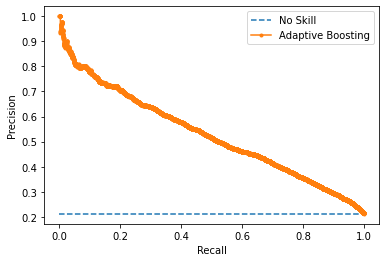

              x         y
0      1.000000  0.213194
1      0.999784  0.213158
2      0.999784  0.213168
3      0.999784  0.213177
4      0.999784  0.213187
5      0.999784  0.213197
6      0.999784  0.213207
7      0.999784  0.213217
8      0.999784  0.213226
9      0.999784  0.213236
10     0.999784  0.213246
11     0.999784  0.213256
12     0.999784  0.213266
13     0.999784  0.213276
14     0.999784  0.213285
15     0.999784  0.213295
16     0.999784  0.213305
17     0.999784  0.213315
18     0.999784  0.213325
19     0.999784  0.213335
20     0.999784  0.213344
21     0.999784  0.213354
22     0.999784  0.213364
23     0.999784  0.213374
24     0.999784  0.213384
25     0.999784  0.213403
26     0.999784  0.213413
27     0.999784  0.213423
28     0.999784  0.213433
29     0.999784  0.213443
30     0.999784  0.213453
31     0.999784  0.213462
32     0.999784  0.213472
33     0.999784  0.213482
34     0.999784  0.213492
35     0.999784  0.213502
36     0.999784  0.213512
37     0.999

In [12]:
#############################################################
###########Precision-recall curve with 336 features--modified##########
#############################################################

from sklearn.preprocessing import StandardScaler
from sklearn.metrics import PrecisionRecallDisplay
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import auc
from matplotlib import pyplot

#model_336 = AdaBoostClassifier(n_estimators=100)
#model_336.fit(X_train, y_train)

#ada = AdaBoostClassifier(n_estimators=100)
#ada.fit(X_train, y_train)

#model_336_pr = AdaBoostClassifier(n_estimators=100)
#model_336_pr.fit(X_train, y_train)
#y_pred_336_pr = cross_val_predict(model_336_pr, X_train, y_train, cv = 7)

#display = PrecisionRecallDisplay.from_predictions(y_train, y_pred_336_pr, name="LDA, 5-fold CV")
#_ = display.ax_.set_title("Precision-Recall curve # 336 features")


# plot no skill and model precision-recall curves
def plot_pr_curve(y_test, model_probs):
	# calculate the no skill line as the proportion of the positive class
	no_skill = len(y_test[y_test==1]) / len(y_test)
	# plot the no skill precision-recall curve
	pyplot.plot([0, 1], [no_skill, no_skill], linestyle='--', label='No Skill')
	# plot model precision-recall curve
	precision, recall, _ = precision_recall_curve(y_test, model_probs)
	pyplot.plot(recall, precision, marker='.', label='Adaptive Boosting')
	# axis labels
	pyplot.xlabel('Recall')
	pyplot.ylabel('Precision')
	# show the legend
	pyplot.legend()
	# show the plot
	pyplot.show()
    

#ada = AdaBoostClassifier(n_estimators= 100)
#model_336_ada = ada.fit(X_train, y_train)
#y_pred_ada = model_336_ada.predict(X_test)



model_336_pr = AdaBoostClassifier(n_estimators=100)
model_336_pr_final = model_336_pr.fit(X_train, y_train)
yhat = model_336_pr_final.predict_log_proba(X_test)
model_probs = yhat[:, 1]
# calculate the precision-recall auc
precision, recall, _ = precision_recall_curve(y_test, model_probs)
auc_score = auc(recall, precision)
print('adaboost PR AUC: %.3f' % auc_score)
# plot precision-recall curves
plot_pr_curve(y_test, model_probs)


df = pd.DataFrame(dict(x = recall,y = precision))
df.to_csv('ldaa.csv')
print(df)
fig = px.line(df, x='x', y='y', title='Precision Recall Curve, LDA')
fig.update_layout(hovermode='closest',template='seaborn',width=700,xaxis=dict(mirror=True,linewidth=2,linecolor='black',showgrid=False),
                 yaxis=dict(mirror=True,linewidth=2,linecolor='black'))



In [13]:
pd.read_csv("ldaa.csv")

,Unnamed: 0,x,y
0,0,1.000000,0.213194
1,1,0.999784,0.213158
2,2,0.999784,0.213168
3,3,0.999784,0.213177
4,4,0.999784,0.213187
5,5,0.999784,0.213197
6,6,0.999784,0.213207
7,7,0.999784,0.213217
8,8,0.999784,0.213226
9,9,0.999784,0.213236


In [16]:
stdev_ada = pd.read_csv("ldaa.csv")

import statistics
statistics.stdev(stdev_ada.y)

0.15809393292047774

/Users/tuheenahmmed/opt/anaconda3/lib/python3.8/site-packages/sklearn/base.py:445: UserWarning:

X does not have valid feature names, but AdaBoostClassifier was fitted with feature names



ValueError: X has 2 features, but AdaBoostClassifier is expecting 336 features as input.

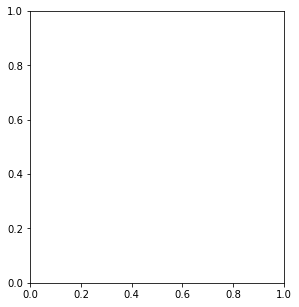

In [14]:
# Author: Noel Dawe <noel.dawe@gmail.com>
#
# License: BSD 3 clause

import numpy as np
import matplotlib.pyplot as plt

from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.datasets import make_gaussian_quantiles



# Create and fit an AdaBoosted decision tree
bdt = AdaBoostClassifier(
    DecisionTreeClassifier(max_depth=1), algorithm="SAMME", n_estimators=200
)

bdt.fit(X_train, y_train)

plot_colors = "br"
plot_step = 0.02
class_names = "AB"

plt.figure(figsize=(10, 5))

# Plot the decision boundaries
plt.subplot(121)
x_min, x_max = X_train.iloc[:, 0].min() - 1, X_train.iloc[:, 0].max() + 1
y_min, y_max = X_train.iloc[:, 1].min() - 1, X_train.iloc[:, 1].max() + 1
xx, yy = np.meshgrid(
    np.arange(x_min, x_max, plot_step), np.arange(y_min, y_max, plot_step)
)

Z = bdt.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)
cs = plt.contourf(xx, yy, Z, cmap=plt.cm.Paired)
plt.axis("tight")

# Plot the training points
for i, n, c in zip(range(2), class_names, plot_colors):
    idx = np.where(y_train == i)
    plt.scatter(
        X_train[idx, 0],
        X_train[idx, 1],
        c=c,
        cmap=plt.cm.Paired,
        s=20,
        edgecolor="k",
        label="Class %s" % n,
    )
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.legend(loc="upper right")
plt.xlabel("x")
plt.ylabel("y")
plt.title("Decision Boundary")

# Plot the two-class decision scores
twoclass_output = bdt.decision_function(X_train)
plot_range = (twoclass_output.min(), twoclass_output.max())
plt.subplot(122)
for i, n, c in zip(range(2), class_names, plot_colors):
    plt.hist(
        twoclass_output[y == i],
        bins=10,
        range=plot_range,
        facecolor=c,
        label="Class %s" % n,
        alpha=0.5,
        edgecolor="k",
    )
x1, x2, y1, y2 = plt.axis()
plt.axis((x1, x2, y1, y2 * 1.2))
plt.legend(loc="upper right")
plt.ylabel("Samples")
plt.xlabel("Score")
plt.title("Decision Scores")

plt.tight_layout()
plt.subplots_adjust(wspace=0.35)
plt.show()

